<a href="https://colab.research.google.com/github/minshyee/BankChurnersPredictProject/blob/main/BankChurners.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
df_origin = pd.read_csv('/content/BankChurners.csv')
df_origin

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.999910
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.999940
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.999980
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.999870
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.999980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0.000191,0.999810
10123,710638233,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0.995270,0.004729
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0.997880,0.002118
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0.996710,0.003294


# EDA

### 전체 데이터 shape, dtype

In [4]:
df_origin.shape, df_origin.dtypes

((10127, 23),
 CLIENTNUM                                                                                                                               int64
 Attrition_Flag                                                                                                                         object
 Customer_Age                                                                                                                            int64
 Gender                                                                                                                                 object
 Dependent_count                                                                                                                         int64
 Education_Level                                                                                                                        object
 Marital_Status                                                                                                                 

In [5]:
#중복확
df_origin[df_origin.duplicated()]

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2


In [6]:
round(df_origin.describe(exclude = ['float', 'int64']),2)

,Attrition_Flag,Gender,Education_Level,Marital_Status,Income_Category,Card_Category
count,10127,10127,10127,10127,10127,10127
unique,2,2,7,4,6,4
top,Existing Customer,F,Graduate,Married,Less than $40K,Blue
freq,8500,5358,3128,4687,3561,9436


### Column별 Data 알아보기

In [ ]:
# print(df_origin['Customer_Age'].value_counts()) -> 앞자리 수만 따서 category화 필요
for i in df_origin.columns:
  print(df_origin[i].value_counts())
  print()

Existing Customer    0.83934
Attrited Customer    0.16066
Name: Attrition_Flag, dtype: float64

780097533    1
720049083    1
717376758    1
720598308    1
719930658    1
            ..
818987958    1
808753758    1
789347133    1
806189658    1
713594883    1
Name: CLIENTNUM, Length: 10127, dtype: int64

Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64

44    500
49    495
46    490
45    486
47    479
43    473
48    472
50    452
42    426
51    398
53    387
41    379
52    376
40    361
39    333
54    307
38    303
55    279
56    262
37    260
57    223
36    221
35    184
59    157
58    157
34    146
60    127
33    127
32    106
65    101
61     93
62     93
31     91
26     78
30     70
63     65
29     56
64     43
27     32
28     29
67      4
66      2
68      2
73      1
70      1
Name: Customer_Age, dtype: int64

F    5358
M    4769
Name: Gender, dtype: int64

3    2732
2    2655
1    1838
4    1574
0     904
5     424
Name: Depende

### Column 별 missing value

In [ ]:
for i in df_origin.columns:
  print(f'{i} Missing Value :{df_origin[i].isnull().sum()}')

CLIENTNUM Missing Value :0
Attrition_Flag Missing Value :0
Customer_Age Missing Value :0
Gender Missing Value :0
Dependent_count Missing Value :0
Education_Level Missing Value :0
Marital_Status Missing Value :0
Income_Category Missing Value :0
Card_Category Missing Value :0
Months_on_book Missing Value :0
Total_Relationship_Count Missing Value :0
Months_Inactive_12_mon Missing Value :0
Contacts_Count_12_mon Missing Value :0
Credit_Limit Missing Value :0
Total_Revolving_Bal Missing Value :0
Avg_Open_To_Buy Missing Value :0
Total_Amt_Chng_Q4_Q1 Missing Value :0
Total_Trans_Amt Missing Value :0
Total_Trans_Ct Missing Value :0
Total_Ct_Chng_Q4_Q1 Missing Value :0
Avg_Utilization_Ratio Missing Value :0
Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1 Missing Value :0
Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2 Missing Value 

수치상으로 결측치가 존재하지 않는 데이터셋이나 Categorical type에서 Unknown이라고 대체된 값이 결측치라 생각할 수 있다.

- Education_Level
- Marital_Status
- Income_Category

In [ ]:
# !pip install -U pandas_profiling

In [ ]:
import pandas_profiling
df_copy = df_origin.copy()
profile = df_copy.profile_report()
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 시각화

## Pre-processing

In [6]:
df = df_origin.copy()
df

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.999910
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.999940
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.999980
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.999870
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.999980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0.000191,0.999810
10123,710638233,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0.995270,0.004729
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0.997880,0.002118
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0.996710,0.003294


#### 나이대 10의 단위별로 바꿔 확인하기

In [7]:
df['Customer_Age'] = df['Customer_Age'].apply(lambda x : int(x/10) * 10)
df

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,40,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.999910
1,818770008,Existing Customer,40,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.999940
2,713982108,Existing Customer,50,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.999980
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.999870
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.999980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0.000191,0.999810
10123,710638233,Attrited Customer,40,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0.995270,0.004729
10124,716506083,Attrited Customer,40,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0.997880,0.002118
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0.996710,0.003294


#### book on months to year


In [8]:
df['Months_on_book'] = df['Months_on_book'].apply(lambda x: int(x/12))
df.rename(columns = {"Months_on_book": "Years_on_book"}, inplace = True)
df

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Years_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,40,M,3,High School,Married,$60K - $80K,Blue,3,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.999910
1,818770008,Existing Customer,40,F,5,Graduate,Single,Less than $40K,Blue,3,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.999940
2,713982108,Existing Customer,50,M,3,Graduate,Married,$80K - $120K,Blue,3,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.999980
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,2,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.999870
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,1,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.999980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,3,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0.000191,0.999810
10123,710638233,Attrited Customer,40,M,2,Unknown,Divorced,$40K - $60K,Blue,2,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0.995270,0.004729
10124,716506083,Attrited Customer,40,F,1,High School,Married,Less than $40K,Blue,3,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0.997880,0.002118
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,3,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0.996710,0.003294


## 전반적인 데이터 시각화

### Target 분포 알아보기

In [9]:
# Exist = 0, Attrited = 0 
df['Attrition_Flag'] = df['Attrition_Flag'].apply(lambda x: 0 if x == 'Existing Customer' else 1)

In [82]:
continuous_feature = [feature for feature in df.columns if df[feature].dtypes != 'O']
import plotly.express as px
Colors = ['#dfd8c7']
## Lets analyse the continuous values by creating histograms to understand the distribution
for feature in continuous_feature:
    data=df.copy()
    fig = px.histogram(df, x= feature,title= 'Distribution of '+ feature,color_discrete_sequence= Colors)
    fig.show()
    print("Skewness: %f" % df['Attrition_Flag'].skew())
    print("Kurtosis: %f" % df['Attrition_Flag'].kurt())

Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


Skewness: 1.848449
Kurtosis: 1.417043


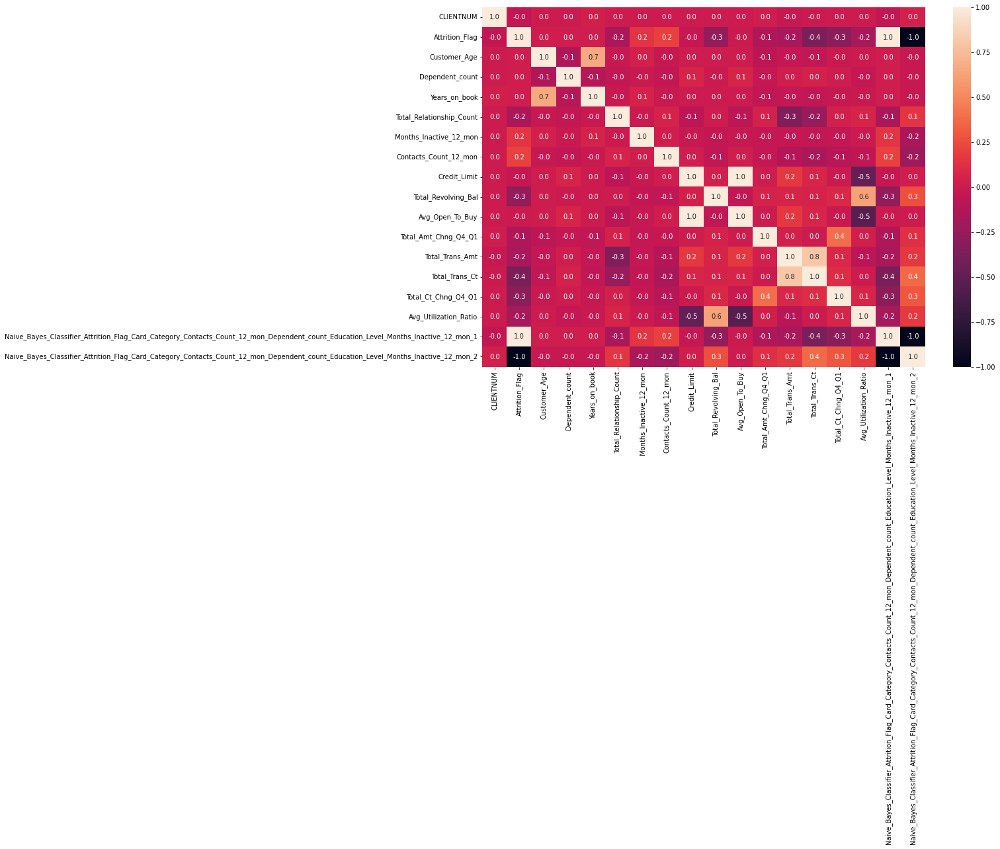

In [83]:
corr = df.corr()
plt.rcParams['figure.figsize'] = [15, 10]
sns.heatmap(corr, annot=True, fmt='.1f')

In [72]:
df.describe()

,CLIENTNUM,Attrition_Flag,Customer_Age,Dependent_count,Years_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
count,1.012700e+04,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000
mean,7.391776e+08,0.160660,41.810013,2.346203,2.637405,3.812580,2.341167,2.455317,8631.953698,1162.814061,7469.139637,0.759941,4404.086304,64.858695,0.712222,0.274894,0.159997,0.840003
std,3.690378e+07,0.367235,8.563195,1.298908,0.726774,1.554408,1.010622,1.106225,9088.776650,814.987335,9090.685324,0.219207,3397.129254,23.472570,0.238086,0.275691,0.365301,0.365301
min,7.080821e+08,0.000000,20.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,510.000000,10.000000,0.000000,0.000000,0.000008,0.000420
25%,7.130368e+08,0.000000,40.000000,1.000000,2.000000,3.000000,2.000000,2.000000,2555.000000,359.000000,1324.500000,0.631000,2155.500000,45.000000,0.582000,0.023000,0.000099,0.999660
50%,7.179264e+08,0.000000,40.000000,2.000000,3.000000,4.000000,2.000000,2.000000,4549.000000,1276.000000,3474.000000,0.736000,3899.000000,67.000000,0.702000,0.176000,0.000181,0.999820
75%,7.731435e+08,0.000000,50.000000,3.000000,3.000000,5.000000,3.000000,3.000000,11067.500000,1784.000000,9859.000000,0.859000,4741.000000,81.000000,0.818000,0.503000,0.000337,0.999900
max,8.283431e+08,1.000000,70.000000,5.000000,4.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,3.397000,18484.000000,139.000000,3.714000,0.999000,0.999580,0.999990


### processing

In [10]:
# df에서 CLIENTNUM, Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,	Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2 삭제
drop_columns = ['CLIENTNUM', 'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1','Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2']
df.drop(drop_columns,axis=1,inplace=True)
df

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Years_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,40,M,3,High School,Married,$60K - $80K,Blue,3,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,0,40,F,5,Graduate,Single,Less than $40K,Blue,3,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,0,50,M,3,Graduate,Married,$80K - $120K,Blue,3,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,0,40,F,4,High School,Unknown,Less than $40K,Blue,2,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,0,40,M,3,Uneducated,Married,$60K - $80K,Blue,1,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,0,50,M,2,Graduate,Single,$40K - $60K,Blue,3,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,1,40,M,2,Unknown,Divorced,$40K - $60K,Blue,2,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,1,40,F,1,High School,Married,Less than $40K,Blue,3,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,1,30,M,2,Graduate,Unknown,$40K - $60K,Blue,3,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


In [11]:
# Gender F: 1 M: 0
df['Gender'] = df['Gender'].apply(lambda x: 1 if x == 'F' else 0)
df

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Years_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,40,0,3,High School,Married,$60K - $80K,Blue,3,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,0,40,1,5,Graduate,Single,Less than $40K,Blue,3,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,0,50,0,3,Graduate,Married,$80K - $120K,Blue,3,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,0,40,1,4,High School,Unknown,Less than $40K,Blue,2,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,0,40,0,3,Uneducated,Married,$60K - $80K,Blue,1,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,0,50,0,2,Graduate,Single,$40K - $60K,Blue,3,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,1,40,0,2,Unknown,Divorced,$40K - $60K,Blue,2,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,1,40,1,1,High School,Married,Less than $40K,Blue,3,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,1,30,0,2,Graduate,Unknown,$40K - $60K,Blue,3,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


In [76]:
# df['R_Ma_Status'] = df['Marital_Status'].apply(lambda x: 1 if (x == 'Single' or x== 'Divorced') else (2 if x=='Married' else 0))

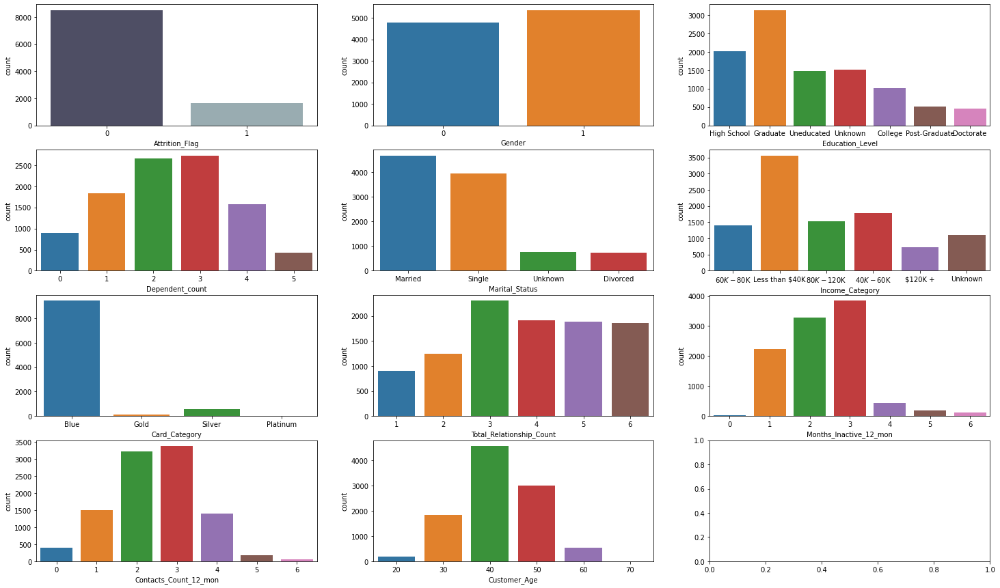

In [14]:
%matplotlib inline

f, axes = plt.subplots(nrows=4, ncols=3, figsize=(25,15))

sns.countplot(x='Attrition_Flag',data=df, ax=axes[0,0],palette='bone')
sns.countplot(x='Gender', data=df, ax=axes[0,1])
sns.countplot(x='Education_Level', data=df, ax=axes[0,2])
sns.countplot(x='Dependent_count', data=df, ax=axes[1,0])
sns.countplot(x='Marital_Status', data=df, ax=axes[1,1])
sns.countplot(x='Income_Category', data=df, ax=axes[1,2])
sns.countplot(x='Card_Category', data=df, ax=axes[2,0])
sns.countplot(x='Total_Relationship_Count', data=df, ax=axes[2,1])
sns.countplot(x='Months_Inactive_12_mon', data=df, ax=axes[2,2])
sns.countplot(x='Contacts_Count_12_mon', data=df, ax=axes[3,0])
sns.countplot(x='Customer_Age', data=df, ax=axes[3,1])
# sns.countplot(x='R_Ma_Status', data=df, ax=axes[3,2])

### 카드 카테고리별 관계확인

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

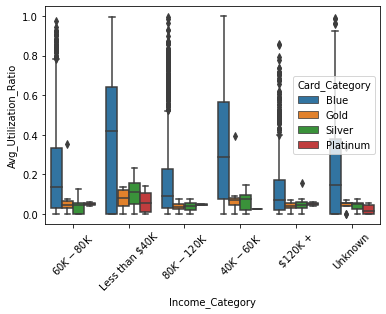

In [15]:
sns.boxplot(x='Income_Category', y='Avg_Utilization_Ratio', hue='Card_Category', data=df)
plt.xticks(rotation =45)

In [16]:
blue = df.loc[df['Card_Category']=='Blue']

# income
b = blue[['Income_Category','Card_Category']]
b = b.groupby('Income_Category').count()
b.columns = ['Blue']

# sex
bs = blue.groupby('Gender')['Card_Category'].count()

# maritual
bm = blue.groupby('Marital_Status')['Card_Category'].count()

# education
be = blue.groupby('Education_Level')['Card_Category'].count()

# on book
bo = blue.groupby('Years_on_book')['Card_Category'].count()

# card limit
bl = pd.DataFrame(blue['Credit_Limit'].describe())


In [17]:
silver = df.loc[df['Card_Category'] == 'Silver']
s = silver[['Income_Category','Card_Category']]
s = s.groupby('Income_Category').count()
s.columns = ['Silver']

# sex
ss = silver.groupby('Gender')['Card_Category'].count()

# maritual
sm = silver.groupby('Marital_Status')['Card_Category'].count()

# education
se = silver.groupby('Education_Level')['Card_Category'].count()

# on book
so = silver.groupby('Years_on_book')['Card_Category'].count()

# card limit
sl = pd.DataFrame(silver['Credit_Limit'].describe())


In [18]:
gold = df.loc[df['Card_Category'] == 'Gold']
g = gold[['Income_Category','Card_Category']]
g = g.groupby('Income_Category').count()
g.columns = ['Gold']

# sex
gs =gold.groupby('Gender')['Card_Category'].count()

# maritual
gm =gold.groupby('Marital_Status')['Card_Category'].count()

# education
ge =gold.groupby('Education_Level')['Card_Category'].count()

# on book
go =gold.groupby('Years_on_book')['Card_Category'].count()

# card limit
gl = pd.DataFrame(gold['Credit_Limit'].describe())

In [19]:
platinum = df.loc[df['Card_Category'] == 'Platinum']
p = platinum[['Income_Category','Card_Category']]
p = p.groupby('Income_Category').count()
p.columns = ['Platinum']

# sex
ps =platinum.groupby('Gender')['Card_Category'].count()

# maritual
pm =platinum.groupby('Marital_Status')['Card_Category'].count()

# education
pe =platinum.groupby('Education_Level')['Card_Category'].count()

# on book
po =platinum.groupby('Years_on_book')['Card_Category'].count()

# card limit
pl = pd.DataFrame(platinum['Credit_Limit'].describe())

#### card_category별 income

In [20]:
chart = pd.concat([b,s,g,p],axis=1).reset_index()
chart

,Income_Category,Blue,Silver,Gold,Platinum
0,$120K +,645,60,18,4
1,$40K - $60K,1675,99,15,1
2,$60K - $80K,1273,96,29,4
3,$80K - $120K,1395,117,21,2
4,Less than $40K,3403,130,24,4
5,Unknown,1045,53,9,5


In [21]:
ch = pd.melt(chart, id_vars=['Income_Category']).dropna()
ch

,Income_Category,variable,value
0,$120K +,Blue,645
1,$40K - $60K,Blue,1675
2,$60K - $80K,Blue,1273
3,$80K - $120K,Blue,1395
4,Less than $40K,Blue,3403
5,Unknown,Blue,1045
6,$120K +,Silver,60
7,$40K - $60K,Silver,99
8,$60K - $80K,Silver,96
9,$80K - $120K,Silver,117


(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

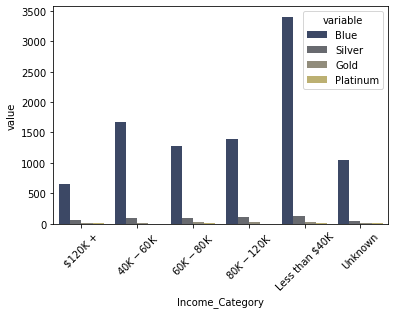

In [22]:
sns.barplot(data=ch,x='Income_Category', y='value', hue='variable',palette='cividis')
plt.xticks(rotation =45)

### Attrition_Flag 별로 데이터 확인

In [86]:
df

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Years_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,40,0,3,High School,Married,$60K - $80K,Blue,3,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,0,40,1,5,Graduate,Single,Less than $40K,Blue,3,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,0,50,0,3,Graduate,Married,$80K - $120K,Blue,3,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,0,40,1,4,High School,Unknown,Less than $40K,Blue,2,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,0,40,0,3,Uneducated,Married,$60K - $80K,Blue,1,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,0,50,0,2,Graduate,Single,$40K - $60K,Blue,3,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,1,40,0,2,Unknown,Divorced,$40K - $60K,Blue,2,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,1,40,1,1,High School,Married,Less than $40K,Blue,3,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,1,30,0,2,Graduate,Unknown,$40K - $60K,Blue,3,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


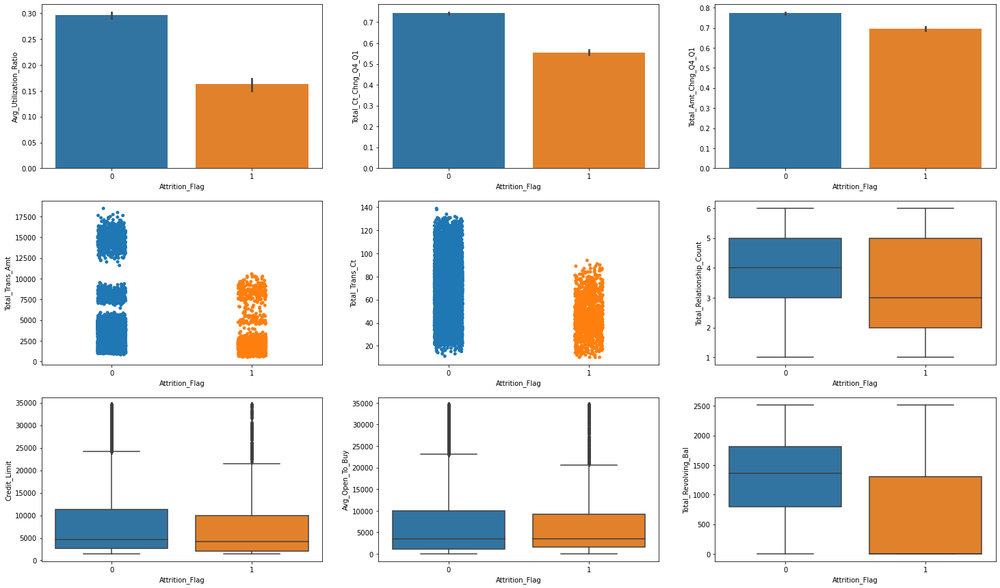

In [23]:
f, axes = plt.subplots(nrows=3, ncols=3, figsize=(25,15))

# 현재 고객과 이탈 고객 간 이용률 차이
sns.barplot(x='Attrition_Flag', y='Avg_Utilization_Ratio', data=df,ax=axes[0,0])

#현재 고객과 이탈 고객 간 새해 거래량 변화
sns.barplot(x='Attrition_Flag', y='Total_Ct_Chng_Q4_Q1', data=df,ax=axes[0,1])
sns.barplot(x='Attrition_Flag', y='Total_Amt_Chng_Q4_Q1', data=df,ax=axes[0,2])

#현재 고객과 이탈 고객 간 총 거래량 차이
sns.stripplot(x='Attrition_Flag', y='Total_Trans_Amt', data=df,ax=axes[1,0])
sns.stripplot(x='Attrition_Flag', y='Total_Trans_Ct', data=df,ax=axes[1,1])

# 현재 고객과 이탈 고객의 상품 수 차이
sns.boxplot(x='Attrition_Flag', y='Total_Relationship_Count', data=df,ax=axes[1,2])

# 현재 고객과 이탈 고객 간 Open to Buy credit line
sns.boxplot(x='Attrition_Flag', y='Credit_Limit', data=df,ax=axes[2,0])
sns.boxplot(x='Attrition_Flag', y='Avg_Open_To_Buy', data=df,ax=axes[2,1])
sns.boxplot(x='Attrition_Flag', y='Total_Revolving_Bal', data=df,ax=axes[2,2])




In [ ]:
df.Total_Relationship_Count.mean()

3.8125802310654686

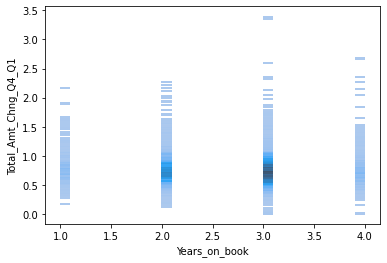

In [24]:
sns.histplot(x=df['Years_on_book'], y=df['Total_Amt_Chng_Q4_Q1'])

In [25]:
# 2년 이상 거래했으나 떠난 사람들
print('2년 이상 거래했으나 떠난 사람들',round(len(df.loc[(df.Years_on_book > 2) & (df.Attrition_Flag == 1)])/len(df.loc[df.Years_on_book > 2])*100,2),'%')

# 2년 이상 거래하고도 남은 사람
print('2년 이상 거래하고도 남은 사람들',round(len(df.loc[(df.Years_on_book > 2) & (df.Attrition_Flag == 0)])/len(df.loc[df.Years_on_book > 2])*100,2),'%')


2년 이상 거래했으나 떠난 사람들 16.76 %
2년 이상 거래하고도 남은 사람들 83.24 %


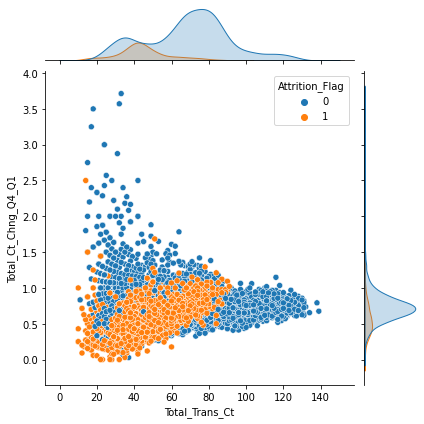

In [26]:
# 전체 거래량 개수 대비 쿼간 변화한 거래 개수
sns.jointplot(x=df['Total_Trans_Ct'],y=df['Total_Ct_Chng_Q4_Q1'],hue=df['Attrition_Flag'])

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16]),
 <a list of 17 Text major ticklabel objects>)

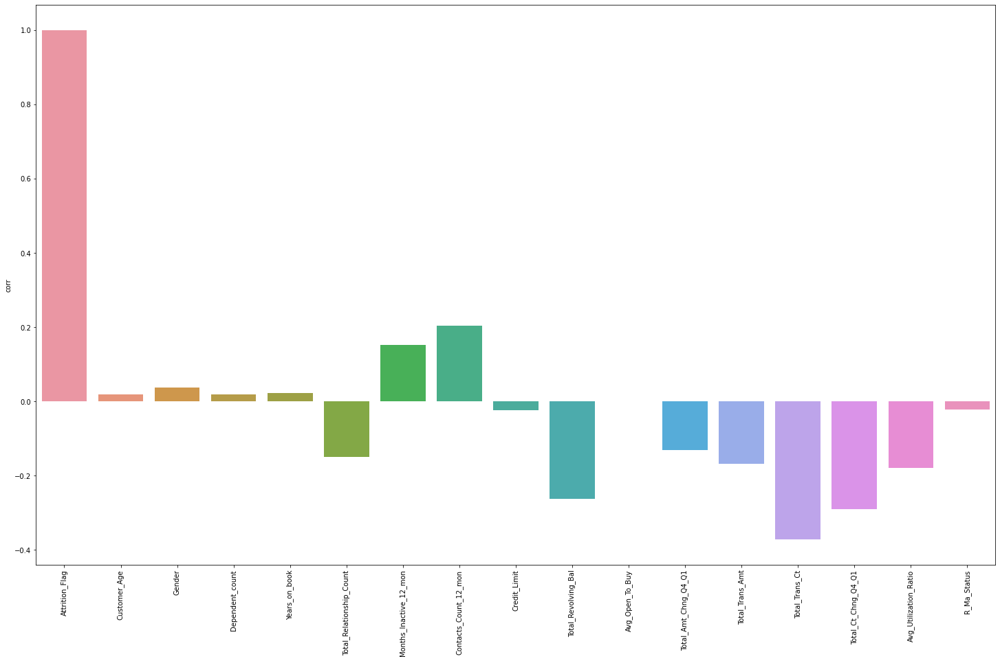

In [21]:
chart_df = pd.DataFrame(df.corrwith(df['Attrition_Flag']))
chart_df.columns = ['corr']
plt.figure(figsize=(25,15))
sns.barplot(x=chart_df.index, y=chart_df['corr'])
plt.xticks(rotation=90)

In [13]:
#카테고리컬 데이터 one-hot (get_dummy이용)
df_new=pd.get_dummies(df, columns=['Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category'],drop_first=False)
df_new

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Years_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Education_Level_College,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$120K +,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Blue,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver
0,0,40,0,3,3,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0
1,0,40,1,5,3,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0
2,0,50,0,3,3,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0
3,0,40,1,4,2,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0
4,0,40,0,3,1,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,0,50,0,2,3,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0
10123,1,40,0,2,2,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,1,0,0,0
10124,1,40,1,1,3,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0
10125,1,30,0,2,3,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0


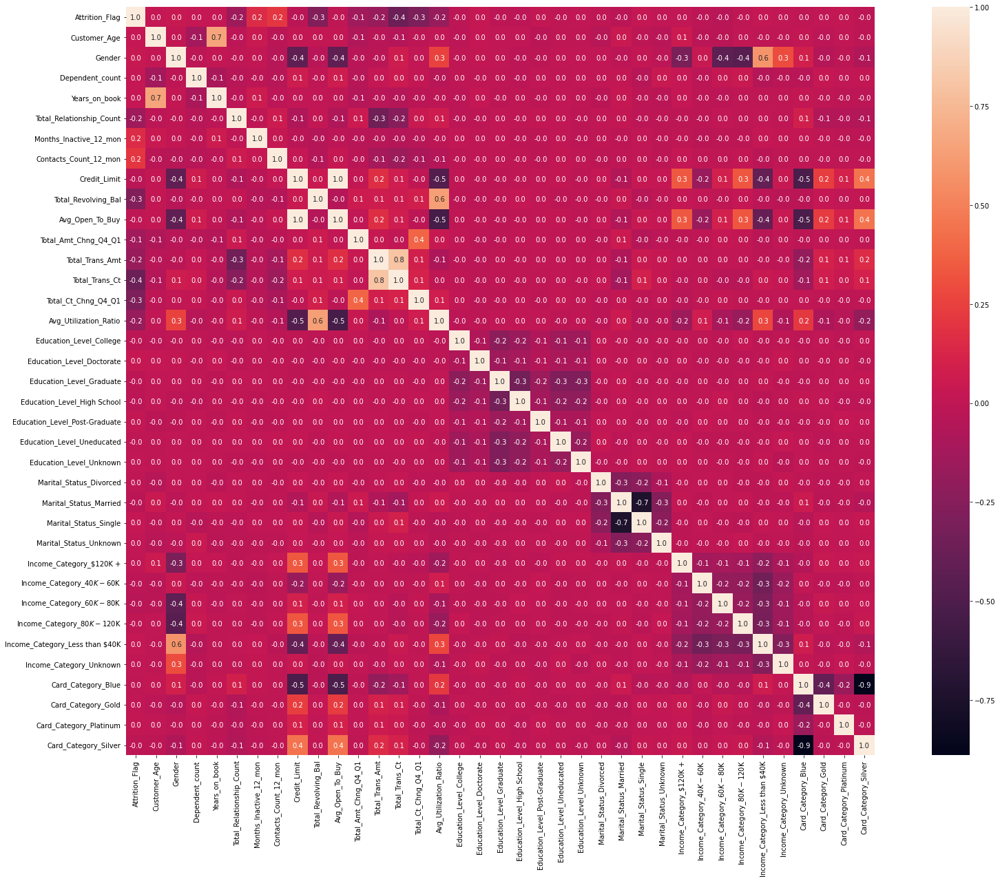

In [88]:
plt.subplots(figsize=(30,20))
sns.heatmap(df_new.corr(),annot=True,square=True,fmt='.1f')

In [33]:
df_new['Customer_Age'].dtypes

dtype('int64')

In [14]:
target = 'Attrition_Flag'
features = df_new.drop(columns=[target]).columns


### Scaling

In [15]:

# 데이터의 단위값을 알기 어려움으로 스케일링을 해줌
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler.fit_transform(df_new.drop(target,axis=1))
scaled_features = scaler.transform(df_new.drop(target,axis=1))

scaled_features = pd.DataFrame(scaled_features, columns = features)
scaled_features

,Customer_Age,Gender,Dependent_count,Years_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Education_Level_College,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$120K +,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Blue,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver
0,0.4,0.0,0.6,0.666667,0.8,0.166667,0.500000,0.340190,0.308701,0.345116,0.392994,0.035273,0.248062,0.437534,0.061061,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,0.4,1.0,1.0,0.666667,1.0,0.166667,0.333333,0.206112,0.343266,0.214093,0.453636,0.043452,0.178295,1.000000,0.105105,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
2,0.6,0.0,0.6,0.666667,0.6,0.166667,0.000000,0.059850,0.000000,0.098948,0.763615,0.076611,0.077519,0.628164,0.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.4,1.0,0.8,0.333333,0.4,0.666667,0.166667,0.056676,1.000000,0.022977,0.413600,0.036775,0.077519,0.628164,0.760761,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
4,0.4,0.0,0.6,0.000000,0.8,0.166667,0.000000,0.099091,0.000000,0.136557,0.640271,0.017025,0.139535,0.673129,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,0.6,0.0,0.4,0.666667,0.4,0.333333,0.500000,0.077536,0.735399,0.062266,0.206947,0.832647,0.829457,0.230749,0.462462,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
10123,0.4,0.0,0.4,0.333333,0.6,0.333333,0.500000,0.085819,0.868494,0.060499,0.236679,0.459219,0.457364,0.183899,0.511512,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
10124,0.4,1.0,0.2,0.666667,0.8,0.500000,0.666667,0.120042,0.000000,0.156637,0.241095,0.544175,0.387597,0.220248,0.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
10125,0.2,0.0,0.4,0.666667,0.6,0.500000,0.500000,0.116172,0.000000,0.152928,0.157492,0.438689,0.403101,0.194400,0.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [16]:
X = scaled_features
y = df_new[target]

In [17]:
# 불균형한 데이터 over sampling
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state=42)
X_smote,y_smote = smote.fit_resample(X,y)

print(f'''SMOTE 전: {X.shape} \nSMOTE 후: {X_smote.shape}''')

print('\n Smote 이후 target값의 비율 (%):')
pd.Series(y_smote).value_counts(normalize=True) * 100

SMOTE 전: (10127, 36) 
SMOTE 후: (17000, 36)

 Smote 이후 target값의 비율 (%):


1    50.0
0    50.0
dtype: float64

## PCA _ dimension Reduction

value [4.93391611e-01 4.27420768e-01 2.61696652e-01 2.05579038e-01
 1.78189583e-01 1.73659560e-01 1.56356929e-01 1.48611851e-01
 1.36534700e-01 1.28427595e-01 1.21660797e-01 1.04227891e-01
 9.32609742e-02 8.57190404e-02 7.14961655e-02 6.89174021e-02
 6.09318794e-02 5.37376365e-02 4.83433950e-02 4.64644539e-02
 3.80460865e-02 2.81569486e-02 2.36166092e-02 2.19248269e-02
 1.54306712e-02 1.27457383e-02 1.09610186e-02 4.81851432e-03
 4.64793795e-03 2.50778400e-03 2.07061937e-03 8.34470665e-31
 8.59969277e-32 1.46954315e-32 7.39959396e-33 5.78039467e-33]
ratio [1.52773884e-01 1.32346658e-01 8.10318072e-02 6.36555374e-02
 5.51746604e-02 5.37719832e-02 4.84143928e-02 4.60162054e-02
 4.22766336e-02 3.97663480e-02 3.76710751e-02 3.22731463e-02
 2.88773480e-02 2.65420620e-02 2.21380880e-02 2.13395991e-02
 1.88669602e-02 1.66393332e-02 1.49690591e-02 1.43872634e-02
 1.17805983e-02 8.71852357e-03 7.31265191e-03 6.78880809e-03
 4.77795633e-03 3.94659313e-03 3.39397214e-03 1.49200580e-03
 1.43918850

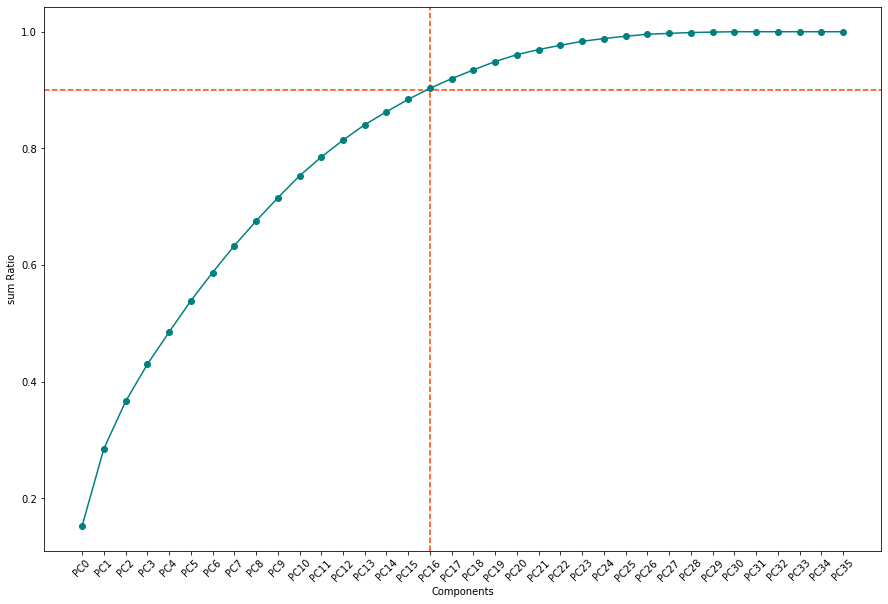

In [18]:
from sklearn.decomposition import PCA
pca_all = PCA()
pca_all.fit(X_smote)
B_pca_all = pca_all.transform(X_smote)

value = pca_all.explained_variance_ #고유값
ratio = pca_all.explained_variance_ratio_ #기여율
n = pca_all.n_components_
print(f'value {value}\nratio {ratio}, component num {n}')

# plt.title("Scree plot")
# plt.xlabel("Number of Components")
# plt.ylabel("contribution level")
# plt.plot(pca_all.explained_variance_ratio_,'ro-')


info = pd.DataFrame({'Eigenvalue': value,'Contribution Ratio': ratio}, index=['PC'+ str(i) for i in range(n)])
info['Sum Ratio'] = np.cumsum(ratio)

plt.figure(figsize=(15,10))
plt.xlabel('Components')
plt.ylabel('sum Ratio')
plt.xticks(rotation=45)
plt.axhline(0.9, ls='--', c='orangered')
plt.axvline(16, ls='--', c='orangered')
plt.plot(info['Sum Ratio'],'o-',c='teal')

In [19]:
pca = PCA(.9) 
pca.fit(X_smote)
X_pca = pca.transform(X_smote)
X_pca = pd.DataFrame(X_pca)

In [20]:
print(f'''Shape of X before PCA: {X_smote.shape}
Shape of X after PCA: {X_pca.shape}''')

Shape of X before PCA: (17000, 36)
Shape of X after PCA: (17000, 17)


In [21]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X_pca,y_smote, train_size=0.8, test_size=0.2, stratify=y_smote, random_state=42)
X_train,X_val,y_train,y_val = train_test_split(X_train,y_train, train_size=0.8, test_size=0.2, stratify=y_train, random_state=42)
print(X_train.shape)
print(X_test.shape)
print(X_val.shape)
print(y_val.shape)
print(y_train.shape)
print(y_test.shape)

(10880, 17)
(3400, 17)
(2720, 17)
(2720,)
(10880,)
(3400,)


# Model Selection

In [22]:
#  Evalution Metric
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix,plot_roc_curve
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, recall_score, roc_auc_score, precision_score,f1_score

In [23]:
from sklearn.tree import DecisionTreeClassifier

tree = DecisionTreeClassifier()
tree.fit(X_train,y_train)
y_pred1 = tree.predict(X_test)
res1 = pd.DataFrame({"Model":['DecisionTreeClassifier'],
                    "Accuracy Score": [accuracy_score(y_pred1,y_test)],
                    "Recall": [recall_score(y_test,y_pred1)],
                    "F1score": [f1_score(y_test,y_pred1)]})
res1

,Model,Accuracy Score,Recall,F1score
0,DecisionTreeClassifier,0.784118,0.83,0.793588


In [24]:
y_pred_val1 = tree.predict(X_val)
print('검증 정확도: ', accuracy_score(y_val, y_pred_val1))
print(classification_report(y_pred_val1, y_val))

검증 정확도:  0.7834558823529412
              precision    recall  f1-score   support

           0       0.75      0.80      0.78      1267
           1       0.82      0.77      0.79      1453

    accuracy                           0.78      2720
   macro avg       0.78      0.78      0.78      2720
weighted avg       0.79      0.78      0.78      2720



In [25]:
from sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier()
rfc.fit(X_train,y_train)
y_pred2 = rfc.predict(X_test)
res2 = pd.DataFrame({"Model":['RandomForestClassifier'],
                    "Accuracy Score": [accuracy_score(y_pred2,y_test)],
                    "Recall": [recall_score(y_test,y_pred2)],
                    "F1score": [f1_score(y_test,y_pred2)]})
res2

,Model,Accuracy Score,Recall,F1score
0,RandomForestClassifier,0.864118,0.884118,0.866782


In [26]:
y_pred_val2 = rfc.predict(X_val)
print('검증 정확도: ', accuracy_score(y_val, y_pred_val2))
print(classification_report(y_pred_val2, y_val))

검증 정확도:  0.8867647058823529
              precision    recall  f1-score   support

           0       0.87      0.90      0.88      1314
           1       0.90      0.87      0.89      1406

    accuracy                           0.89      2720
   macro avg       0.89      0.89      0.89      2720
weighted avg       0.89      0.89      0.89      2720



In [27]:
from xgboost import XGBClassifier

xgb = XGBClassifier(
    n_estimators=1000,
    max_depth=7,
    learning_rate=0.2,
    n_jobs=-1)
xgb.fit(X_train,y_train)
y_pred3 = xgb.predict(X_test)
res3 = pd.DataFrame({"Model":['XGBClassifier'],
                    "Accuracy Score": [accuracy_score(y_pred3,y_test)],
                    "Recall": [recall_score(y_test,y_pred3)],
                    "F1score": [f1_score(y_test,y_pred3)]})
res3


,Model,Accuracy Score,Recall,F1score
0,XGBClassifier,0.883235,0.911765,0.886474


In [28]:
# validation
y_pred_val3 = xgb.predict(X_val)
print('검증 정확도: ', accuracy_score(y_val, y_pred_val3))
print(classification_report(y_pred_val3, y_val))

검증 정확도:  0.8952205882352942
              precision    recall  f1-score   support

           0       0.86      0.92      0.89      1271
           1       0.93      0.87      0.90      1449

    accuracy                           0.90      2720
   macro avg       0.90      0.90      0.90      2720
weighted avg       0.90      0.90      0.90      2720



## PCA 사용 X

In [29]:
from sklearn.model_selection import train_test_split
X_train0,X_test2,y_train0,y_test2 = train_test_split(X_smote,y_smote, train_size=0.8, test_size=0.2, stratify=y_smote, random_state=42)
X_train2, X_val2, y_train2, y_val2 = train_test_split(X_train0,y_train0, train_size=0.8, test_size=0.2, stratify=y_train0, random_state=42)
print(X_train0.shape)
print(X_test2.shape)
print(X_val2.shape)
print(y_val2.shape)
print(y_train0.shape)
print(y_test2.shape)

(13600, 36)
(3400, 36)
(2720, 36)
(2720,)
(13600,)
(3400,)


In [31]:
from xgboost import XGBClassifier

xgb = XGBClassifier()
xgb.fit(X_train2,y_train2)
y_pred4 = xgb.predict(X_test2)
res4 = pd.DataFrame({"Model":['XGBClassifier'],
                    "Accuracy Score": [accuracy_score(y_pred4,y_test)],
                    "Recall": [recall_score(y_test,y_pred4)],
                    "F1score": [f1_score(y_test,y_pred4)]})
res4

,Model,Accuracy Score,Recall,F1score
0,XGBClassifier,0.975,0.974118,0.974978


In [32]:
# validation
y_pred_val4 = xgb.predict(X_val2)
print('검증 정확도: ', accuracy_score(y_val2, y_pred_val4))
print(classification_report(y_pred_val4, y_val2))

검증 정확도:  0.9680147058823529
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      1369
           1       0.96      0.97      0.97      1351

    accuracy                           0.97      2720
   macro avg       0.97      0.97      0.97      2720
weighted avg       0.97      0.97      0.97      2720



In [33]:
from xgboost import XGBClassifier

xgb = XGBClassifier(
    n_estimators=1000,
    max_depth=7,
    learning_rate=0.2,
    n_jobs=-1)
xgb.fit(X_train2,y_train2)
y_pred5 = xgb.predict(X_test2)
res5 = pd.DataFrame({"Model":['XGBClassifier'],
                    "Accuracy Score": [accuracy_score(y_pred5,y_test)],
                    "Recall": [recall_score(y_test,y_pred5)],
                    "F1score": [f1_score(y_test,y_pred5)]})
res5

,Model,Accuracy Score,Recall,F1score
0,XGBClassifier,0.982941,0.980588,0.982901


In [34]:
# validation
y_pred_val5 = xgb.predict(X_val2)
print('검증 정확도: ', accuracy_score(y_val2, y_pred_val5))
print(classification_report(y_pred_val5, y_val2))

검증 정확도:  0.9830882352941176
              precision    recall  f1-score   support

           0       0.99      0.98      0.98      1374
           1       0.98      0.99      0.98      1346

    accuracy                           0.98      2720
   macro avg       0.98      0.98      0.98      2720
weighted avg       0.98      0.98      0.98      2720



# Model Building & Hyper parameter tune
 - Model : XGBoost

In [55]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint, uniform
params = {
   "colsample_bytree": uniform(0.3, 0.7),
   "min_child_weight": [1,2,3,4],
   "learning_rate": uniform(0.1, 0.5), # default 0.1 
   "max_depth": randint(6, 9), # default 3
   "n_estimators": randint(100, 300), # default 100
   "subsample": uniform(0.6, 0.4)
}
xgb_rscv = RandomizedSearchCV(xgb, 
                              param_distributions = params, 
                              scoring = "recall",
                              cv = 3, 
                              verbose = 2,
                              n_jobs=-1, 
                              random_state = 42)
xgb_rscv.fit(X_train, y_train)

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:  1.3min finished


RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                           colsample_bylevel=1,
                                           colsample_bynode=1,
                                           colsample_bytree=1, gamma=0,
                                           learning_rate=0.2, max_delta_step=0,
                                           max_depth=7, min_child_weight=1,
                                           missing=None, n_estimators=1000,
                                           n_jobs=-1, nthread=None,
                                           objective='binary:logistic',
                                           random_state=0, reg_alpha=0,
                                           reg_lambda=1,...
                                        'max_depth': <scipy.stats._distn_infrastructure.rv_frozen object at 0x7f90cb2d8c90>,
                                        'min_child_we

In [56]:
xgb_rscv.best_estimator_

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.7282970263056656, gamma=0,
              learning_rate=0.16974693032602092, max_delta_step=0, max_depth=8,
              min_child_weight=2, missing=None, n_estimators=289, n_jobs=-1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=0.9140703845572055, verbosity=1)

In [36]:
# xgb_rscv.best_estimator_
xgb_tune = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.7282970263056656, gamma=0,
              learning_rate=0.16974693032602092, max_delta_step=0, max_depth=8,
              min_child_weight=2, missing=None, n_estimators=289, n_jobs=-1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=0.9140703845572055, verbosity=1)
xgb_tune.fit(X_train2,y_train2)
res6 = pd.DataFrame({"Model":['XGBClassifier'],
                    "Accuracy Score": [accuracy_score(y_pred5,y_test2)],
                    "Recall": [recall_score(y_test2,y_pred5)],
                    "F1score": [f1_score(y_test2,y_pred5)]})
res6

,Model,Accuracy Score,Recall,F1score
0,XGBClassifier,0.982941,0.980588,0.982901


In [37]:
y_pred_val5 = xgb_tune.predict(X_val2)
print('검증 정확도: ', accuracy_score(y_val2, y_pred_val5))
print(classification_report(y_pred_val5, y_val2))

검증 정확도:  0.9841911764705882
              precision    recall  f1-score   support

           0       0.99      0.98      0.98      1371
           1       0.98      0.99      0.98      1349

    accuracy                           0.98      2720
   macro avg       0.98      0.98      0.98      2720
weighted avg       0.98      0.98      0.98      2720



In [58]:
from sklearn.model_selection import GridSearchCV

grid_params = {
   "colsample_bytree": [0.690,0.728],
   "learning_rate": [0.2, 0.25, 0.3], # default 0.1 
   "max_depth": [7, 8], # default 3
   "n_estimators": [1000, 1200], # default 100
   "subsample": [0.86, 0.914]
}

grid_search = GridSearchCV(xgb, grid_params, cv = 3, n_jobs = -1, verbose = 1)
grid_search.fit(X_train, y_train)

Fitting 3 folds for each of 48 candidates, totalling 144 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed: 10.0min
[Parallel(n_jobs=-1)]: Done 144 out of 144 | elapsed: 31.3min finished


GridSearchCV(cv=3, error_score=nan,
             estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                     colsample_bylevel=1, colsample_bynode=1,
                                     colsample_bytree=1, gamma=0,
                                     learning_rate=0.2, max_delta_step=0,
                                     max_depth=7, min_child_weight=1,
                                     missing=None, n_estimators=1000, n_jobs=-1,
                                     nthread=None, objective='binary:logistic',
                                     random_state=0, reg_alpha=0, reg_lambda=1,
                                     scale_pos_weight=1, seed=None, silent=None,
                                     subsample=1, verbosity=1),
             iid='deprecated', n_jobs=-1,
             param_grid={'colsample_bytree': [0.69, 0.728],
                         'learning_rate': [0.2, 0.25, 0.3], 'max_depth': [7, 8],
                         'n_estimato

In [60]:
grid_search.best_params_

{'colsample_bytree': 0.728,
 'learning_rate': 0.25,
 'max_depth': 8,
 'n_estimators': 1000,
 'subsample': 0.914}

In [39]:
xgb_detail_tune_PCA = XGBClassifier(colsample_bytree=0.728,
                                learning_rate=0.25,
                                max_depth= 8,
                                n_estimators=1000,
                                subsample=0.91)
xgb_detail_tune_PCA.fit(X_train,y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.728, gamma=0,
              learning_rate=0.25, max_delta_step=0, max_depth=8,
              min_child_weight=1, missing=None, n_estimators=1000, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=0.91, verbosity=1)

In [40]:
y_pred_val6 = xgb_detail_tune_PCA.predict(X_val)
print('검증 정확도: ', accuracy_score(y_val, y_pred_val6))
print(classification_report(y_pred_val6, y_val))

검증 정확도:  0.8941176470588236
              precision    recall  f1-score   support

           0       0.86      0.92      0.89      1278
           1       0.92      0.87      0.90      1442

    accuracy                           0.89      2720
   macro avg       0.89      0.90      0.89      2720
weighted avg       0.90      0.89      0.89      2720



In [41]:
xgb_detail_tune = XGBClassifier(colsample_bytree=0.728,
                                learning_rate=0.25,
                                max_depth= 8,
                                n_estimators=1000,
                                subsample=0.91)
xgb_detail_tune.fit(X_train2,y_train2)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.728, gamma=0,
              learning_rate=0.25, max_delta_step=0, max_depth=8,
              min_child_weight=1, missing=None, n_estimators=1000, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=0.91, verbosity=1)

In [42]:
y_pred_val7 = xgb_detail_tune.predict(X_val2)
print('검증 정확도: ', accuracy_score(y_val2, y_pred_val7))
print(classification_report(y_pred_val7, y_val2))

검증 정확도:  0.9834558823529411
              precision    recall  f1-score   support

           0       0.99      0.98      0.98      1379
           1       0.98      0.99      0.98      1341

    accuracy                           0.98      2720
   macro avg       0.98      0.98      0.98      2720
weighted avg       0.98      0.98      0.98      2720



# 최종 모델

In [ ]:
#최종 모델 스펙
# xgb_detail_tune = XGBClassifier(colsample_bytree=0.728,
#                                 learning_rate=0.25,
#                                 max_depth= 8,
#                                 n_estimators=1000,
#                                 subsample=0.91)
# xgb_detail_tune.fit(X_train2,y_train2)

In [43]:
y_pred = xgb_detail_tune.predict(X_test2)
print('검증 정확도: ', accuracy_score(y_test2, y_pred))
print(classification_report(y_pred, y_test2))

검증 정확도:  0.9838235294117647
              precision    recall  f1-score   support

           0       0.99      0.98      0.98      1705
           1       0.98      0.99      0.98      1695

    accuracy                           0.98      3400
   macro avg       0.98      0.98      0.98      3400
weighted avg       0.98      0.98      0.98      3400



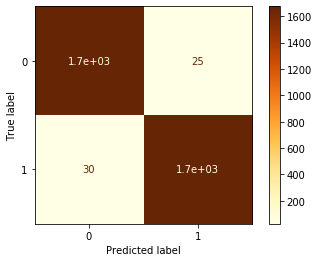

In [44]:
plot_confusion_matrix(xgb_detail_tune,X_test2,y_test2,cmap='YlOrBr')

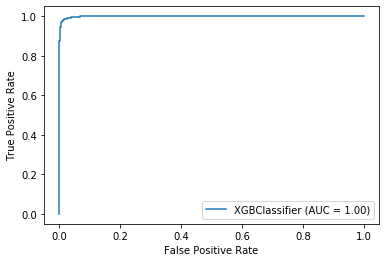

In [45]:
plot_roc_curve(xgb_detail_tune,X_test2,y_test2)

In [46]:
feat_importance = xgb_detail_tune.feature_importances_
feat_importance = pd.DataFrame(feat_importance,columns=['Score'],index=features)
feat_importance

,Score
Customer_Age,0.030415
Gender,0.041671
Dependent_count,0.019893
Years_on_book,0.019417
Total_Relationship_Count,0.060922
Months_Inactive_12_mon,0.097840
Contacts_Count_12_mon,0.053845
Credit_Limit,0.007912
Total_Revolving_Bal,0.064955
Avg_Open_To_Buy,0.007832


In [47]:
feat_importance.sort_values(by='Score',ascending=False).style.background_gradient(cmap='OrRd')

,Score
Total_Trans_Ct,0.154877
Months_Inactive_12_mon,0.097840
Total_Revolving_Bal,0.064955
Total_Relationship_Count,0.060922
Contacts_Count_12_mon,0.053845
Income_Category_Unknown,0.045340
Gender,0.041671
Education_Level_Post-Graduate,0.034670
Total_Ct_Chng_Q4_Q1,0.032371
Customer_Age,0.030415


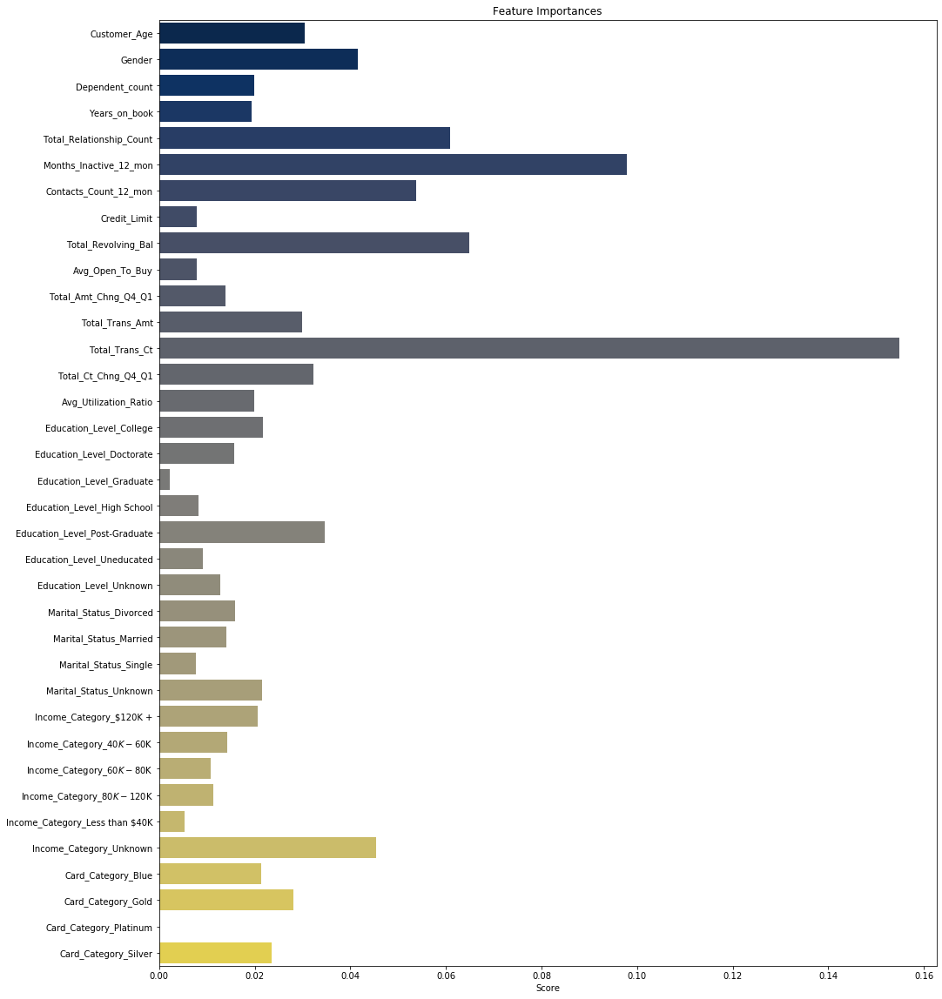

In [48]:
plt.figure(figsize=(16,20))
plt.title('Feature Importances')
sns.barplot(x=feat_importance.Score,y=feat_importance.index, palette='cividis')

In [ ]:
# !pip install shap
# !pip install pdpbox

In [1]:
from pdpbox.pdp import pdp_isolate, pdp_plot
import shap

In [62]:
X_test_shap = pd.DataFrame(X_test2)
X_test_shap.columns = features
X_test_shap

,Customer_Age,Gender,Dependent_count,Years_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Education_Level_College,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$120K +,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Blue,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver
0,0.600000,0.0,0.400000,0.333333,0.400000,0.333333,0.500000,0.294751,0.000000,0.324081,0.193700,0.088962,0.286822,0.167205,0.000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,0.332982,1.0,0.667018,0.333333,0.800000,0.444151,0.555849,0.006547,0.000000,0.047862,0.184691,0.094090,0.330572,0.184038,0.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
2,0.200000,0.0,0.000000,0.333333,0.788863,0.333333,0.391982,0.080613,0.000000,0.118847,0.267658,0.447224,0.483918,0.148744,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.600000,1.0,0.200000,0.666667,0.800000,0.166667,0.166667,0.005221,0.372666,0.019413,0.176921,0.199010,0.589147,0.245288,0.582583,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,0.400000,0.0,0.800000,0.333333,0.800000,0.500000,0.500000,0.717997,0.514501,0.692203,0.163968,0.055803,0.217054,0.156974,0.051051,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3395,0.440640,1.0,0.479680,0.666667,1.000000,0.166667,0.399733,0.058673,0.000000,0.097820,0.300004,0.151558,0.256310,0.222683,0.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
3396,0.200000,1.0,0.145321,0.424465,0.600000,0.378899,0.545566,0.006580,0.000000,0.047893,0.224318,0.114511,0.385421,0.149299,0.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
3397,0.400000,1.0,1.000000,0.333333,0.200000,0.166667,0.500000,0.132285,0.467223,0.134297,0.184575,0.182820,0.496124,0.284330,0.202202,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
3398,0.600000,1.0,0.400000,0.666667,0.000000,0.333333,0.333333,0.020428,0.000000,0.061165,0.257580,0.131412,0.271318,0.134626,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0


In [63]:
row = X_test_shap.iloc[[3160]]
row

,Customer_Age,Gender,Dependent_count,Years_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Education_Level_College,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Education_Level_Unknown,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$120K +,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Blue,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver
3160,0.2,1.0,0.6,0.333333,0.6,0.333333,0.666667,0.060636,0.969805,0.028975,0.460112,0.120062,0.317829,0.146742,0.70971,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0


In [70]:
explainer = shap.TreeExplainer(xgb_detail_tune)
shap_values = explainer.shap_values(X_test_shap)

shap.initjs()
shap.force_plot(
    base_value=explainer.expected_value, 
    shap_values=shap_values, 
    features=X_test_shap.columns, 
    link='logit' # SHAP value를 확률로 변환해 표시합니다.
)

In [75]:
X_train_shap = pd.DataFrame(X_train2)
X_train_shap.columns = features
X_val_shap = pd.DataFrame(X_val2)
X_val_shap.columns = features

In [80]:
shap_values.shape,X_train_shap.shape

((3400, 36), (10880, 36))

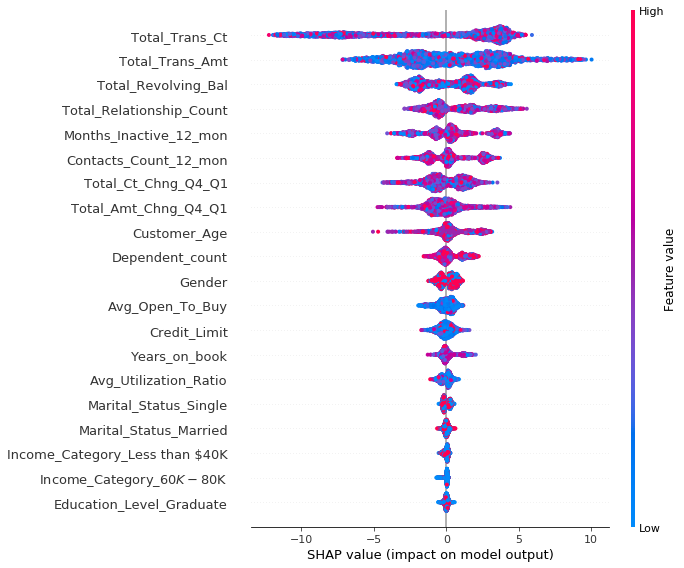

In [81]:
shap.summary_plot(shap_values, X_train_shap[:3400])

In [69]:
feature_names = row.columns
feature_values = row.values[0]
shaps = pd.Series(shap_values[0], zip(feature_names, feature_values))

pros = shaps.sort_values(ascending=False)[:3].index
cons = shaps.sort_values(ascending=True)[:3].index

print('Customer Churn 예측에 대한 Positive 요인 Top 3 입니다:')
for i, pro in enumerate(pros, start=1):
    feature_name, feature_value = pro
    print(f'{i}. {feature_name} : {feature_value}')

print('\n')
print('Negative 요인 Top 3 입니다:')
for i, con in enumerate(cons, start=1):
    feature_name, feature_value = con
    print(f'{i}. {feature_name} : {feature_value}')

Customer Churn 예측에 대한 Positive 요인 Top 3 입니다:
1. Total_Trans_Amt : 0.12006231222877489
2. Total_Trans_Ct : 0.3178294573643411
3. Total_Ct_Chng_Q4_Q1 : 0.14674205708131396


Negative 요인 Top 3 입니다:
1. Total_Amt_Chng_Q4_Q1 : 0.46011186340889026
2. Customer_Age : 0.19999999999999996
3. Total_Relationship_Count : 0.6000000000000001
